In [1]:
import joblib
import numpy as np
import pandas as pd
import scipy.io as sio
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

from cplAE_TE.utils.preproc_helpers import get_spc_names_v2, standardize_E, scale_E_scores

In [2]:
# Read processed transcriptomic annotations. Note that `spec_id_label` is used to identify cells in E data, whereas `sample_id` is used for T data. T_annotations has both these fields.
T_ann = pd.read_csv('/Users/fruity/Dropbox/AllenInstitute/CellTypes/dat/proc/patchseq-inh/T_annotations.csv')

### Electrophysiology data

In [3]:
pth = {}
base_pth = '/Users/fruity/Dropbox/AllenInstitute/CellTypes/dat/raw/patchseq-inh/'
pth['E_pc_z_scored'] = base_pth + 'sparse_pca_components_mMET_revision_Apr2020_v2.csv'
pth['E_ipfx'] = base_pth + 'ipfx_features.csv'
pth['E_pkl'] = base_pth + 'spca_loadings_mMET_revision_Apr2020_v2.pkl'

**Note**

PC = principle components
 - `E_pc_zscored` or `E_pc_zscored_rem_outliers` will not be not used for further analysis. 
 - Instead we will scale the different sub-experiments by the number of PC that were retained
 - The number of PC retained is decided based on the amount of variance of the original time series they can explain. (Gouwens et al. 2019)
 - We choose to reflect this by weighting the total variance in the features (i.e. PC scores) per sub-experiment by the number of PC used to describe that experiment. 

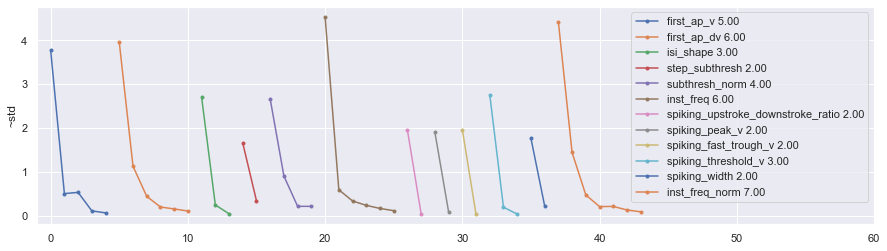

In [4]:
# Get z-scored principle component scores
spc_features = get_spc_names_v2()
E_pc_zscored = pd.read_csv(pth['E_pc_z_scored'])
E_pc_zscored.columns=['spec_id_label']+spc_features.tolist()

# Get 'scaled' principle component scores
L = joblib.load(pth['E_pkl'])
E_pc_scaled,  TimeSeries, TimeSeries_scaled = scale_E_scores(L)
E_pc_scaled.insert(loc=0,column='spec_id_label',value=E_pc_zscored.spec_id_label.values)


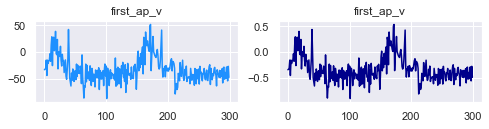

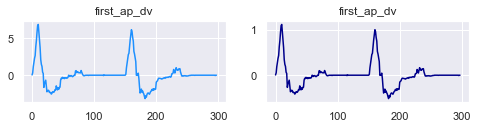

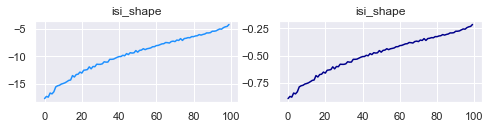

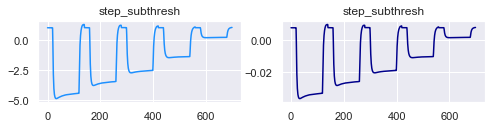

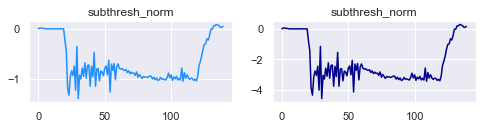

...

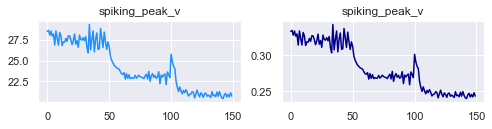

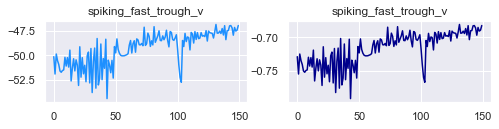

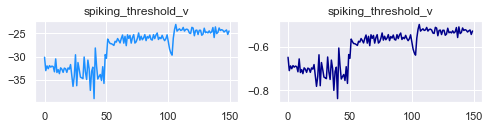

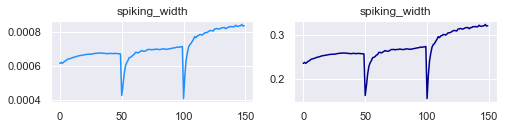

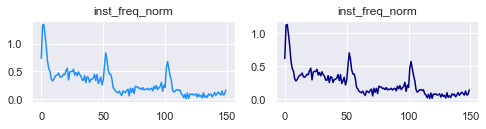

In [5]:
# spot checks of time series reconstructions with original and scaled scores.
cellid = 1000
for sub_expt in TimeSeries.keys():
    plt.figure(figsize=(8,1.5))
    plt.subplot(1,2,1)
    plt.plot(TimeSeries[sub_expt][cellid,:],color='dodgerblue')
    plt.title(sub_expt)
    
    plt.subplot(1,2,2)
    plt.plot(TimeSeries_scaled[sub_expt][cellid,:],color='darkblue')
    plt.title(sub_expt)
    plt.show()

In [6]:
# checks 
assert T_ann['spec_id_label'].dtype == E_pc_zscored['spec_id_label'].dtype, 'dtype mismatch'

# order cells as per transcriptomic data
E_pc_zscored = E_pc_zscored[E_pc_zscored['spec_id_label'].isin(T_ann['spec_id_label'])]
E_pc_zscored.set_index(keys='spec_id_label', inplace=True)
E_pc_zscored = E_pc_zscored.reindex(labels=T_ann['spec_id_label'])
E_pc_zscored.reset_index(drop=False, inplace=True)

# remove extreme outliers
E_pc_zscored_rem_outliers, _, _ = standardize_E(df=E_pc_zscored.copy(), feature_list=E_pc_zscored.columns[1:].tolist(), z_absmax=6.0, plots=False, verbose=False)

In [7]:
# checks
assert T_ann['spec_id_label'].dtype == E_pc_scaled['spec_id_label'].dtype, 'dtype mismatch'

# order cells as per transcriptomic data
E_pc_scaled = E_pc_scaled[E_pc_scaled['spec_id_label'].isin(T_ann['spec_id_label'])]
E_pc_scaled.set_index(keys='spec_id_label', inplace=True)
E_pc_scaled = E_pc_scaled.reindex(labels=T_ann['spec_id_label'])
E_pc_scaled.reset_index(drop=False, inplace=True)

In [8]:
# Get IPFX features
E_ipfx = pd.read_csv(pth['E_ipfx'])
E_ipfx.rename(columns = {'specimen_id': 'spec_id_label'}, inplace=True)

# checks
assert T_ann['spec_id_label'].dtype == E_ipfx['spec_id_label'].dtype, 'dtype mismatch'

# Restrict and re-order E dataset rows to match T dataset order
E_ipfx = E_ipfx[E_ipfx['spec_id_label'].isin(T_ann['spec_id_label'])]
E_ipfx.set_index(keys='spec_id_label', inplace=True)
E_ipfx = E_ipfx.reindex(labels=T_ann['spec_id_label'])
E_ipfx.reset_index(drop=False, inplace=True)

In [9]:
# Remove ramp related features (not consistently measured for patch-seq cells re. Agata)
keep_ipfx_features_bioarxiv = ['ap_1_threshold_v_short_square', 'ap_1_peak_v_short_square',
       'ap_1_upstroke_short_square', 'ap_1_downstroke_short_square',
       'ap_1_upstroke_downstroke_ratio_short_square',
       'ap_1_width_short_square', 'ap_1_fast_trough_v_short_square',
       'short_square_current', 'input_resistance', 'tau', 'v_baseline',
       'sag_nearest_minus_100', 'sag_measured_at', 'rheobase_i',
       'ap_1_threshold_v_0_long_square', 'ap_1_peak_v_0_long_square',
       'ap_1_upstroke_0_long_square', 'ap_1_downstroke_0_long_square',
       'ap_1_upstroke_downstroke_ratio_0_long_square',
       'ap_1_width_0_long_square', 'ap_1_fast_trough_v_0_long_square',
       'avg_rate_0_long_square', 'latency_0_long_square',
       'stimulus_amplitude_0_long_square']

# Making sure that selection criteria for intrinsic physiology features (ipfx) returns the same features as used for Gala et al. 2021
keep_ipfx_features_ = E_ipfx.isna().sum()<=0.1*E_ipfx.shape[0]
keep_ipfx_features_ = keep_ipfx_features_[keep_ipfx_features_].index.tolist()
keep_ipfx_features_ = [f for f in keep_ipfx_features_ if 'ramp' not in f ]
keep_ipfx_features_ = [f for f in keep_ipfx_features_ if 'mean' not in f]
keep_ipfx_features_ = [f for f in keep_ipfx_features_ if 'fi_' not in f]
assert set(keep_ipfx_features_bioarxiv)==set(keep_ipfx_features_)-set(['spec_id_label']), 'This criteria leads to different feature set than the dataset in Gala et al. 2021'

# keep only features curated for the Gala et al. 2020 paper
E_ipfx = E_ipfx[['spec_id_label']+keep_ipfx_features_bioarxiv]

# remove extreme outliers
E_ipfx_norm, _, _ = standardize_E(df=E_ipfx.copy(), feature_list=E_ipfx.columns[1:].tolist(), z_absmax=6.0, plots=False, verbose=False)

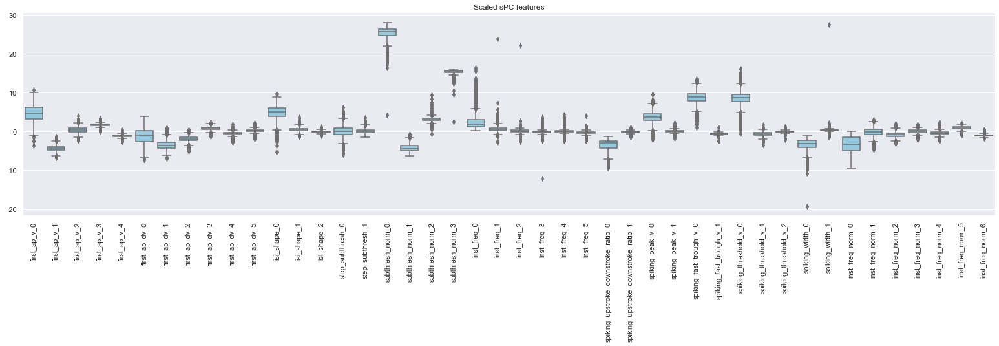

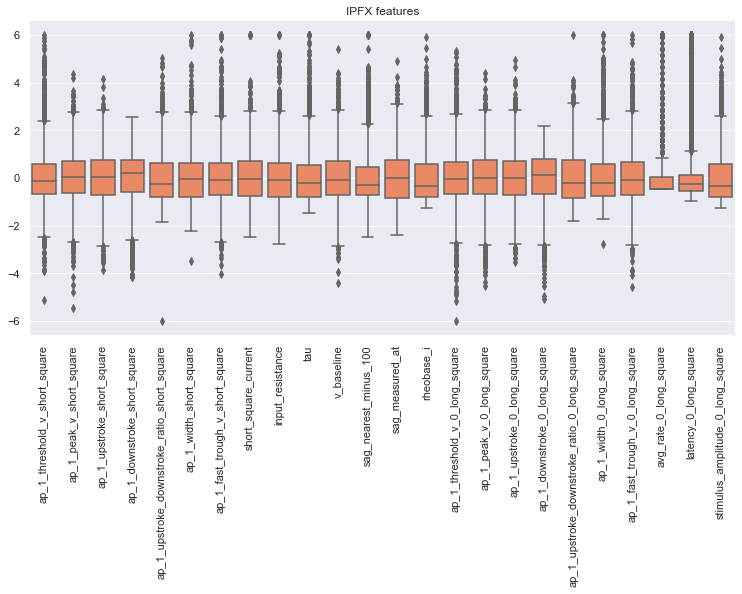

In [10]:
df = E_pc_scaled.melt(value_vars=E_pc_scaled.columns[1:])
sns.catplot(x="variable", y="value",kind='box', data=df, palette=sns.color_palette(["skyblue"]),aspect=4.4)
ax = plt.gca()
ax.set(**{'title':'Scaled sPC features','xlabel':'','ylabel':''})
ax.set_xticklabels(ax.get_xticklabels(),rotation=90)
plt.show()

df = E_ipfx_norm.melt(value_vars=E_ipfx_norm.columns[1:])
sns.catplot(x="variable", y="value",kind='box', data=df, palette=sns.color_palette(["coral"]),aspect=2.4)
ax = plt.gca()
ax.set(**{'title':'IPFX features','xlabel':'','ylabel':''})
ax.set_xticklabels(ax.get_xticklabels(),rotation=90)
plt.show()

In [11]:
# features used as autoencoder input
E_features = E_pc_scaled.merge(right=E_ipfx_norm, how='left', left_on='spec_id_label', right_on='spec_id_label')

# show nans
na_values = E_features.isna().sum(axis=0)
na_values[na_values>0]

ap_1_threshold_v_short_square                   4
ap_1_peak_v_short_square                        4
ap_1_upstroke_short_square                      4
ap_1_downstroke_short_square                    4
ap_1_upstroke_downstroke_ratio_short_square     4
ap_1_width_short_square                         4
ap_1_fast_trough_v_short_square                 4
short_square_current                            4
input_resistance                                4
tau                                             7
v_baseline                                      4
sag_nearest_minus_100                           4
sag_measured_at                                 4
rheobase_i                                      4
ap_1_threshold_v_0_long_square                  4
ap_1_peak_v_0_long_square                       4
ap_1_upstroke_0_long_square                     4
ap_1_downstroke_0_long_square                   4
ap_1_upstroke_downstroke_ratio_0_long_square    4
ap_1_width_0_long_square                        5


In [12]:
E_features.to_csv('/Users/fruity/Dropbox/AllenInstitute/CellTypes/dat/proc/patchseq-inh/E_data.csv',index=False)

In [14]:
# Define plot friendly, short names for E features:
E_name_dict = {'first_ap_v_0':'spc0 first AP v',
    'first_ap_v_1':'spc1 first AP v',
    'first_ap_v_2':'spc2 first AP v',
    'first_ap_v_3':'spc3 first AP v',
    'first_ap_v_4':'spc4 first AP v',
    'first_ap_dv_0':'spc0 first AP dv',
    'first_ap_dv_1':'spc1 first AP dv',
    'first_ap_dv_2':'spc2 first AP dv',
    'first_ap_dv_3':'spc3 first AP dv',
    'first_ap_dv_4':'spc4 first AP dv',
    'first_ap_dv_5':'spc5 first AP dv',
    'isi_shape_0':'spc0 ISI shape',
    'isi_shape_1':'spc1 ISI shape',
    'isi_shape_2':'spc2 ISI shape',
    'step_subthresh_0':'spc0 step subthr.',
    'step_subthresh_1':'spc1 step subthr.',
    'subthresh_norm_0':'spc0 subthr. norm',
    'subthresh_norm_1':'spc1 subthr. norm',
    'subthresh_norm_2':'spc2 subthr. norm',
    'subthresh_norm_3':'spc3 subthr. norm',
    'inst_freq_0':'spc0 inst. freq.',
    'inst_freq_1':'spc1 inst. freq.',
    'inst_freq_2':'spc2 inst. freq.',
    'inst_freq_3':'spc3 inst. freq.',
    'inst_freq_4':'spc4 inst. freq.',
    'inst_freq_5':'spc5 inst. freq.',
    'spiking_upstroke_downstroke_ratio_0':'spc0 spk. up-down ratio',
    'spiking_upstroke_downstroke_ratio_1':'spc1 spk. up-down ratio',
    'spiking_peak_v_0':'spc0 spk. peak v',
    'spiking_peak_v_1':'spc1 spk. peak v',
    'spiking_fast_trough_v_0':'spc0 spk. fast trough v',
    'spiking_fast_trough_v_1':'spc1 spk. fast trough v',
    'spiking_threshold_v_0':'spc0 spk. thr. v',
    'spiking_threshold_v_1':'spc1 spk. thr. v',
    'spiking_threshold_v_2':'spc2 spk. thr. v',
    'spiking_width_0':'spc0 spk. width',
    'spiking_width_1':'spc1 spk. width',
    'inst_freq_norm_0':'spc0 inst. freq. norm',
    'inst_freq_norm_1':'spc1 inst. freq. norm',
    'inst_freq_norm_2':'spc2 inst. freq. norm',
    'inst_freq_norm_3':'spc3 inst. freq. norm',
    'inst_freq_norm_4':'spc4 inst. freq. norm',
    'inst_freq_norm_5':'spc5 inst. freq. norm',
    'inst_freq_norm_6':'spc6 inst. freq. norm',
    'ap_1_threshold_v_short_square':'Short sq. AP1 thr. v',
    'ap_1_peak_v_short_square':'Short sq. AP1 peak v',
    'ap_1_upstroke_short_square':'Short sq. AP1 upstroke',
    'ap_1_downstroke_short_square':'Short sq. AP1 downstroke',
    'ap_1_upstroke_downstroke_ratio_short_square':'Short sq. AP1 up-down ratio',
    'ap_1_width_short_square':'Short sq. AP1 width',
    'ap_1_fast_trough_v_short_square':'Short sq. AP1 fast trough v',
    'short_square_current':'Short sq. current',
    'input_resistance':'Input resistance',
    'tau':'tau',
    'v_baseline':'v baseline',
    'sag_nearest_minus_100':'Sag nearest minus 100',
    'sag_measured_at':'Sag measured at',
    'rheobase_i':'Rheobase i',
    'ap_1_threshold_v_0_long_square': 'Long sq. AP1 threshold v',
    'ap_1_peak_v_0_long_square': 'Long sq. AP1 peak v',
    'ap_1_upstroke_0_long_square': 'Long sq. AP1 upstroke',
    'ap_1_downstroke_0_long_square': 'Long sq. AP1 downstroke',
    'ap_1_upstroke_downstroke_ratio_0_long_square': 'Long sq. AP1 up-down ratio',
    'ap_1_width_0_long_square': 'Long sq. AP1 width',
    'ap_1_fast_trough_v_0_long_square': 'Long sq. AP1 fast trough v',
    'avg_rate_0_long_square': 'Long sq. avg. rate',
    'latency_0_long_square': 'Long sq. latency',
    'stimulus_amplitude_0_long_square': 'Long sq. stim. amp.'}

import json
with open('/Users/fruity/Dropbox/AllenInstitute/CellTypes/dat/proc/patchseq-inh/E_feature_names.json', 'w') as f:
    json.dump(E_name_dict, f)

### Comparison with dataset included in Gala et al. 2021

Principle components were recalculated, and one can expect them to be the same upto a sign. This shows up in the mean values of the new dataset.

In [15]:
E_new = E_features.copy()

In [16]:
from cplAE_TE.utils.load_helpers import get_paths, load_dataset, load_summary_files

#Assemble E features from v1 of the dataset
O = load_dataset(min_sample_thr=10)
E_old = pd.DataFrame({key:O['XE'][:,i] for i,key in enumerate(np.concatenate([O['pc_name'],O['feature_name']]))})
E_old.insert(loc=0, column='spec_id_label', value=O['E_spec_id_label'].astype('int'))
assert np.array_equal(E_old.columns.values,E_new.columns.values), 'Columns are not the same'
feature_names = E_new.columns[1:].tolist()

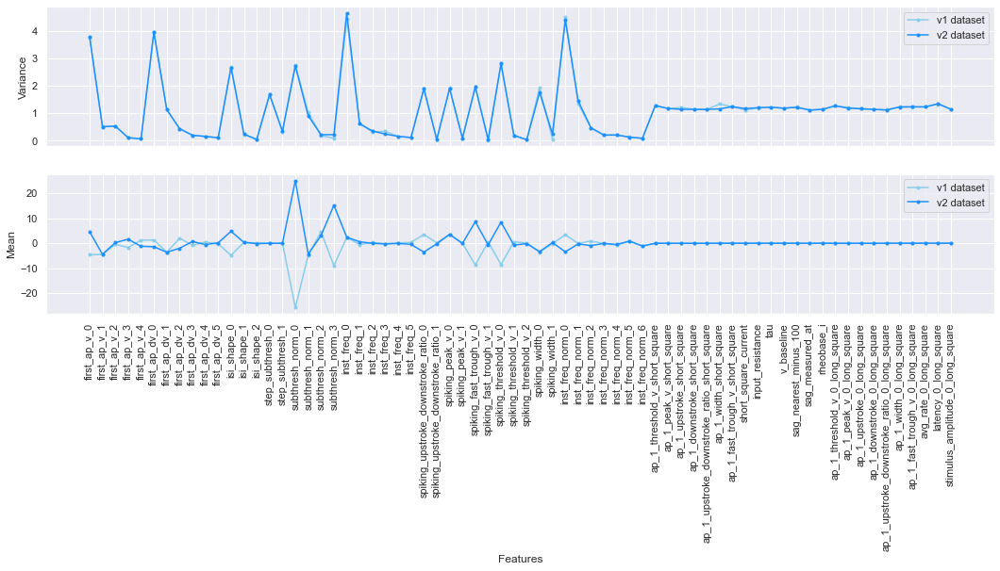

In [17]:
plt.figure(figsize=(18,6))
plt.subplot(211)
plt.plot(E_old[E_old.columns[1:]].var(axis=0),'.-',color='skyblue',label='v1 dataset')
plt.plot(E_new[E_new.columns[1:]].var(axis=0),'.-',color='dodgerblue',label='v2 dataset')
ax=plt.gca()
ax.set(**{'xlabel':'','ylabel':'Variance','xticks':np.arange(len(feature_names)),'xticklabels':[]})
plt.legend()

plt.subplot(212)
plt.plot(E_old[E_old.columns[1:]].mean(axis=0),'.-',color='skyblue',label='v1 dataset')
plt.plot(E_new[E_new.columns[1:]].mean(axis=0),'.-',color='dodgerblue',label='v2 dataset')
ax=plt.gca()
ax.set(**{'xlabel':'Features','ylabel':'Mean','xticks':np.arange(len(feature_names)),'xticklabels':feature_names})
ax.set_xticklabels(ax.get_xticklabels(),rotation=90)
plt.legend()
plt.show()

### Comparing the same cells:
 - `E_new` is restricted below to the same cells as in the old dataset
 - There are some differences in the IPFX features for the same cells between old and new versions (ask Nathan/Agata what changed.)

In [18]:
E_new = E_new[E_new['spec_id_label'].isin(E_old['spec_id_label'])]
E_new.set_index(keys='spec_id_label', inplace=True)
E_new = E_new.reindex(labels=E_old['spec_id_label'])
E_new.reset_index(drop=False, inplace=True)

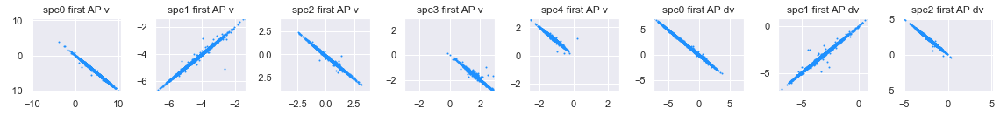

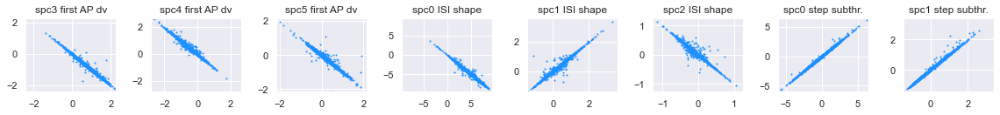

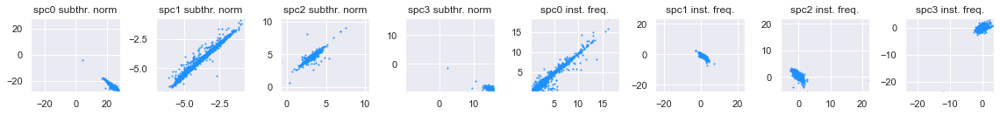

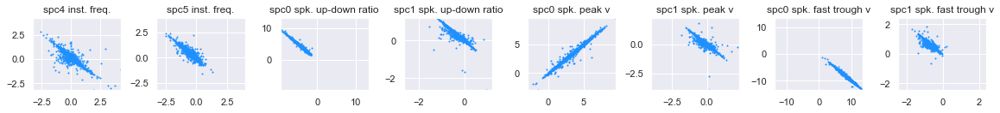

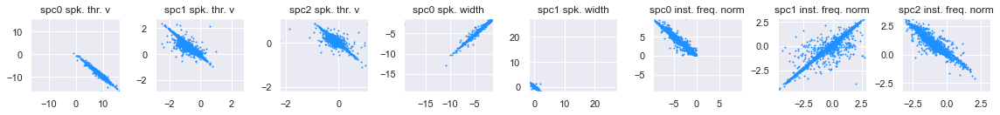

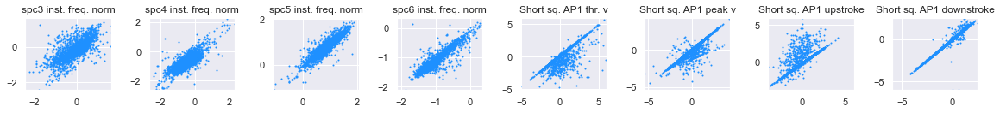

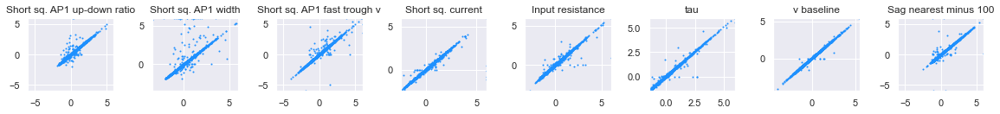

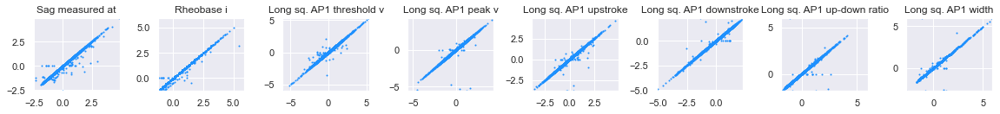

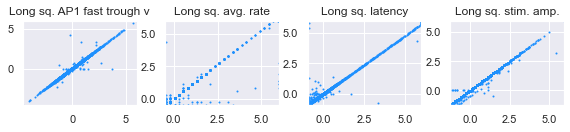

In [19]:
n_cols=8
for i,key in enumerate(feature_names):
    if i%n_cols==0: plt.figure(figsize=(16,2))
    plt.subplot(1,n_cols,i%n_cols+1)
    plt.scatter(E_new[key],E_old[key],s=1,alpha=1,c='dodgerblue')
    lims=(np.min([E_old[key].min(),E_new[key].min()]), np.max([E_old[key].max(),E_new[key].max()]))
    ax=plt.gca()
    ax.set(**{'xlim':lims,'ylim':lims,'title':E_name_dict[key]})
    if (i+1)%n_cols == 0:
        plt.tight_layout()
        plt.show()
plt.tight_layout()
plt.show()